In [2]:
%load_ext autoreload
%autoreload 2

import scanpy as sc
import yaml
import json
import os
import sys
sys.path.append('../')
sys.path.append('../hovernet')
sys.path.append('../hedest')

PATH = '/home/luca/Documents/data/'
# '/cluster/CBIO/data1/lgortana/'
# '/home/luca/Documents/data_CBIO/'
# '/home/luca/Documents/data/'

# Data information

In [3]:
#load adata
adata_name = 'Visium_Human_Breast_Cancer'
data_path = os.path.join(PATH, adata_name)
path_ST_adata = os.path.join(data_path, 'ST')
adata = sc.read_visium(path_ST_adata) #read_visium or read_h5ad

#image path
image_path = os.path.join(data_path, 'pyr_tif/Visium_Human_Breast_Cancer_image.tif')

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


# Segmentation

If you already have segmentation infos inside a json file, please go directly to [Step 3 - Load data](#load_data). If you need to perform segmentation, please follow all the steps.

## Step 1 - Create mask

In [ ]:
from hovernet.mask_utils import make_auto_mask

mask = make_auto_mask(image_path, mask_level=3, save=os.path.join(data_path, 'mask/CytAssist_FFPE_Sagittal_Mouse_Brain_tissue_image.png'))

## Step 2 - HoverNet Segmentation

Now that you have you own mask and the high-resolution WSI, you need to run the run_hovernet.sh. Your command should look like this :

In [ ]:
python ../hover_net/run_infer.py \
    --gpu='0,1' \
    --nr_types=0 \
    --type_info_path=../hover_net/type_info.json \
    --model_mode=fast \
    --model_path=/cluster/CBIO/data1/lgortana/pretrained/seg_classif/hovernet_fast_pannuke_type_tf2pytorch.tar \
    wsi \
    --input_dir=/cluster/CBIO/data1/lgortana/Xenium_V1_humanLung_Cancer_FFPE/tif/ \
    --output_dir=/cluster/CBIO/data1/lgortana/Xenium_V1_humanLung_Cancer_FFPE/seg_json/ \
    --input_mask_dir=data/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma/mask/lvl3/ \

## Step 3 - Load data <a id="load_data"></a>

In [4]:
import pandas as pd

#load image infos
json_path = os.path.join(data_path, 'seg_json/pannuke_fast_mask_lvl3.json')
with open(json_path) as json_file:
    hovernet_dict = json.load(json_file)

# Load the dictionary with the types and colors
dict_types_colors_path = "../references/colors_hovernet.yaml"
with open(dict_types_colors_path, 'r') as file:
    dict_types_colors = yaml.load(file, Loader=yaml.FullLoader)["pannuke"]

# Spot proportions
# spot_prop_df = pd.read_csv(os.path.join(data_path, f'C2L_{adata_name}_prop.csv'), index_col=0)
# spot_prop_df.index = spot_prop_df.index.astype(str)

In [5]:
ct_list = [item[0] for item in list(dict_types_colors.values())]

In [6]:
from hedest.analysis.postseg import count_cell_types
count_cell_types(hovernet_dict, ct_list)

,no-neo,connec,neopla,nolabe,necros,inflam
0,38089,49146,93843,9442,543,501


# Segmentation analysis
## Plot slide and segmented nuclei

In [11]:
from hedest.analysis.postseg import StdVisualizer

plotter = StdVisualizer(image_path=image_path,
                        adata=adata,
                        adata_name=adata_name,
                        seg_dict=hovernet_dict,
                        color_dict=dict_types_colors)

Visium data found.


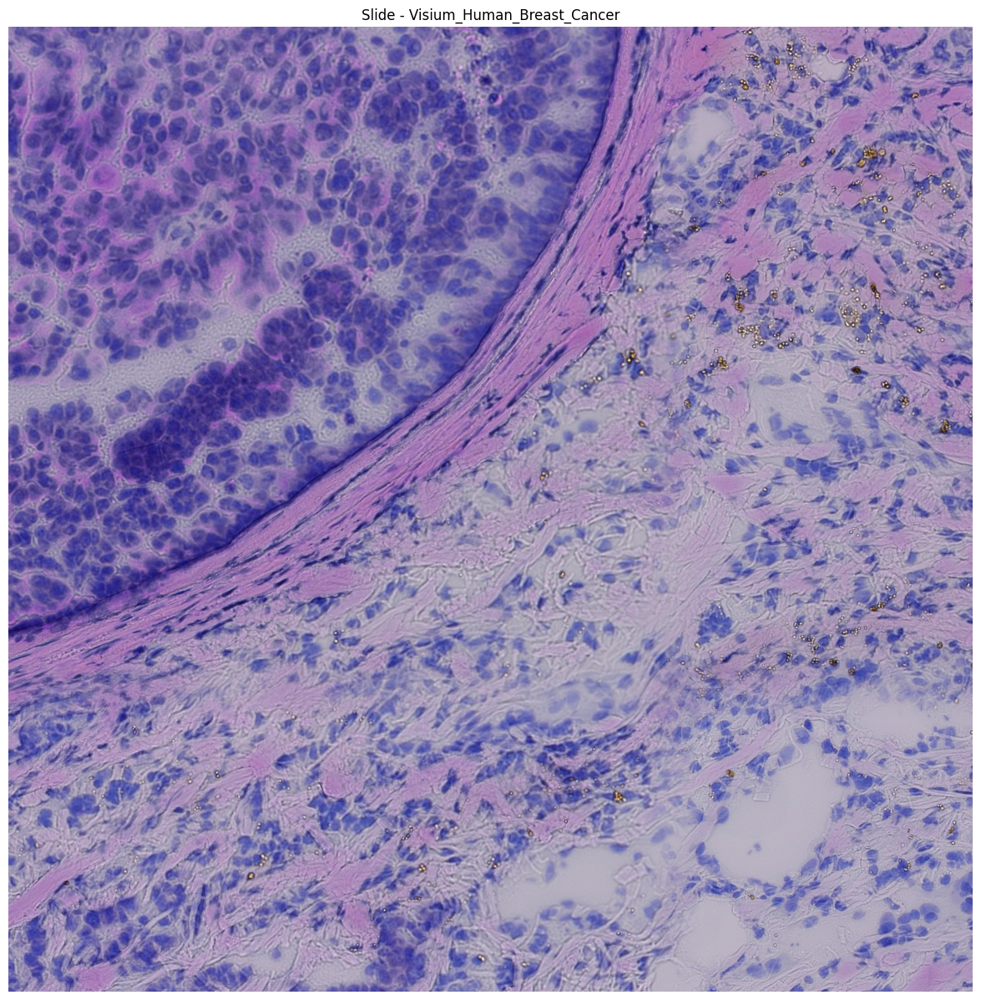

In [17]:
window = ((12500, 12500), (2000, 2000))
plotter.plot_slide(window=window)

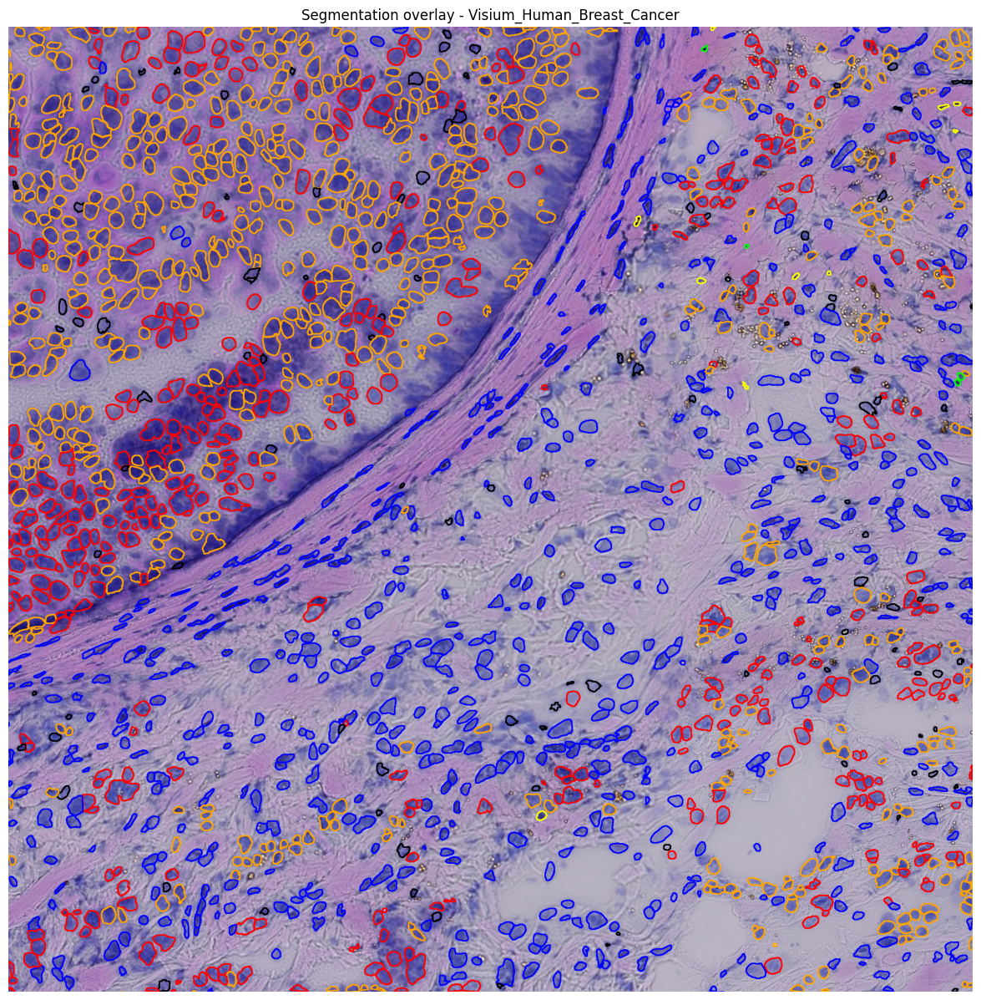

In [18]:
plotter.plot_seg(window=window, show_visium=False)

In [9]:
plotter.plot_specific_spot(spot_id='GGATCTTGACTCAACC-1')

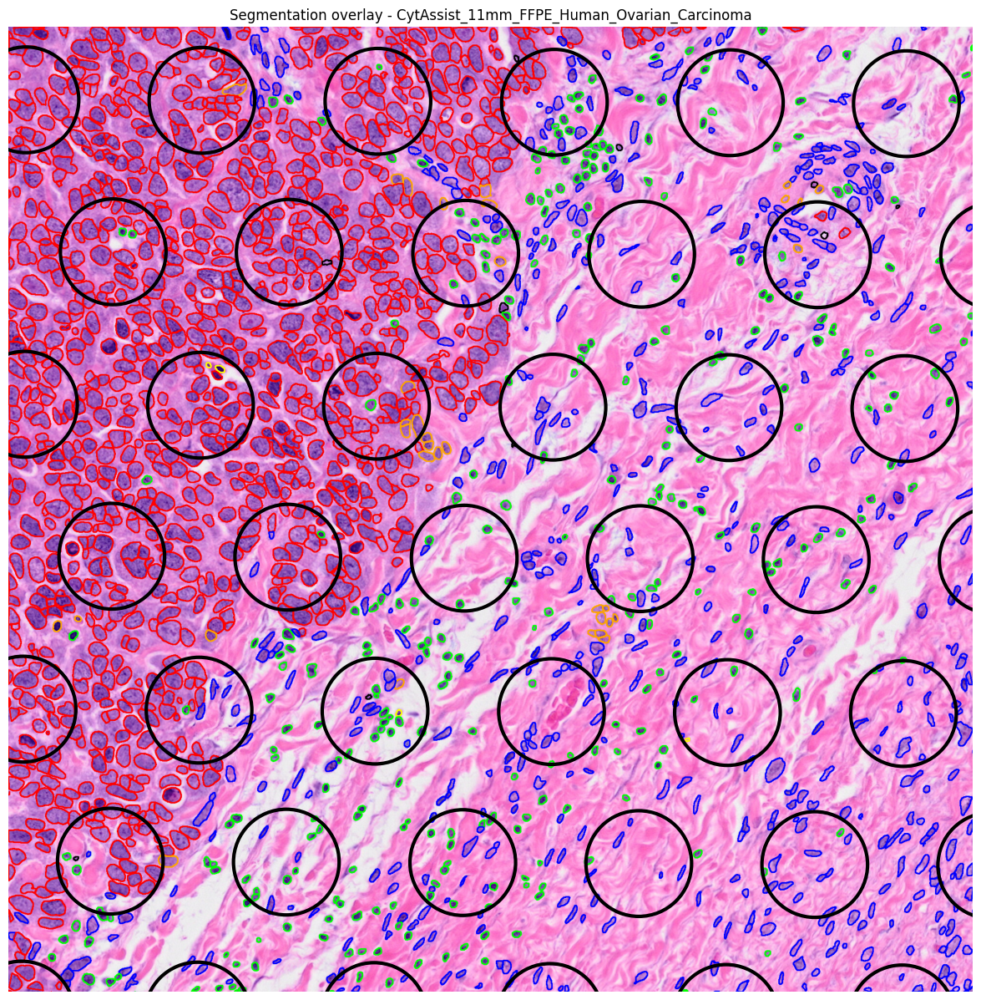

In [15]:
plotter.plot_seg(window, show_visium=True, draw_dot=False)

In [ ]:
from hedest.postseg import IntVisualizer

plotter_int = IntVisualizer(image_path, 
                            adata, 
                            adata_name, 
                            dict_cells=json_path, 
                            dict_types_colors=dict_types_colors)

Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


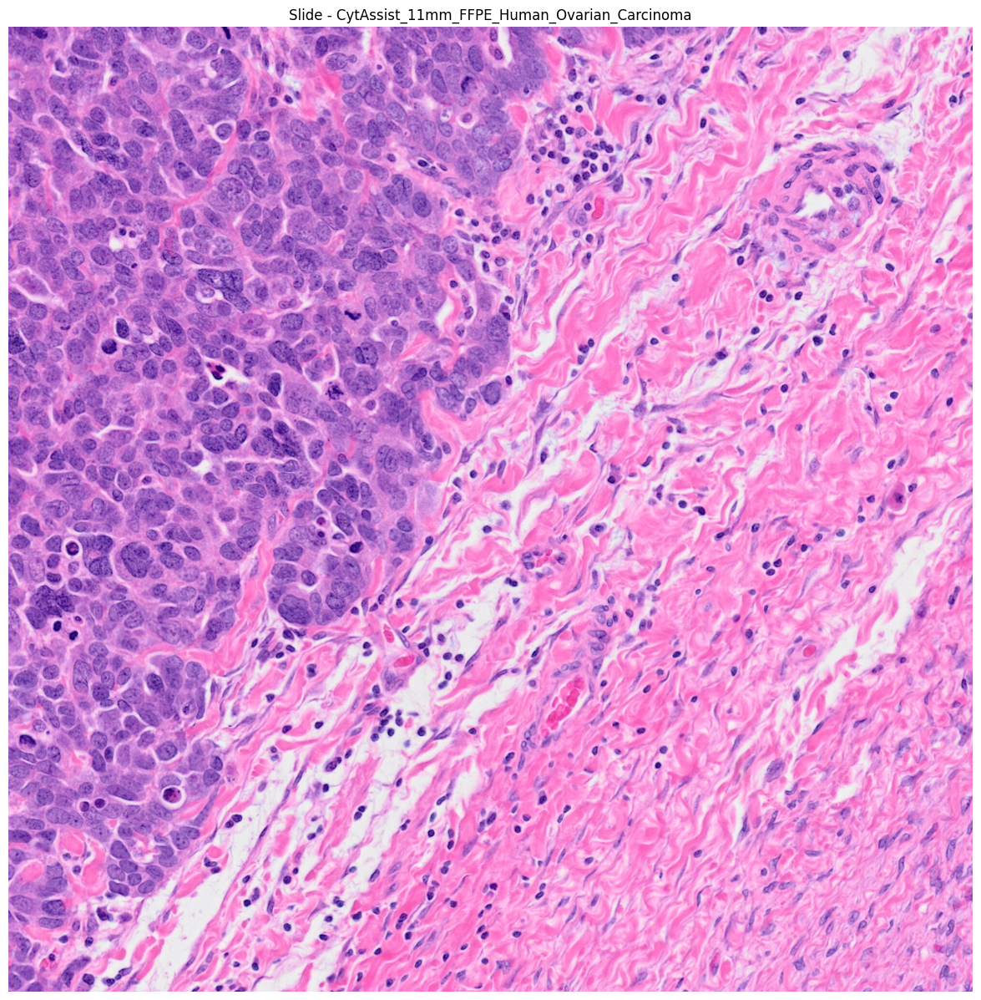

In [18]:
plotter_int.plot_slide(window, show_visium=False)

In [20]:
plotter_int.plot_seg(window, show_visium=False)

In [21]:
plotter_int.plot_specific_spot()

Randomly selected spot_id: GTGCAGGCAGGCCTCA-1


# Map cells to spots

In [10]:
from hedest.analysis.postseg import map_cells_to_spots

dict_cell2spot = map_cells_to_spots(adata, adata_name, json_path)

2025-08-13 16:21:58.386 | INFO     | hedest.config:flush:29 - Mapping cells to spots:   0%|          | 0/191564 [00:00<?, ?it/s]
2025-08-13 16:21:58.487 | INFO     | hedest.config:flush:29 - Mapping cells to spots:  12%|#2        | 23040/191564 [00:00<00:00, 230386.49it/s]
2025-08-13 16:21:58.587 | INFO     | hedest.config:flush:29 - Mapping cells to spots:  24%|##4       | 46079/191564 [00:00<00:00, 230309.87it/s]
2025-08-13 16:21:58.687 | INFO     | hedest.config:flush:29 - Mapping cells to spots:  36%|###6      | 69328/191564 [00:00<00:00, 231300.99it/s]
2025-08-13 16:21:58.787 | INFO     | hedest.config:flush:29 - Mapping cells to spots:  48%|####8     | 92707/191564 [00:00<00:00, 232276.80it/s]
2025-08-13 16:21:58.887 | INFO     | hedest.config:flush:29 - Mapping cells to spots:  61%|######    | 115994/191564 [00:00<00:00, 232483.98it/s]
2025-08-13 16:21:58.988 | INFO     | hedest.config:flush:29 - Mapping cells to spots:  73%|#######2  | 139243/191564 [00:00<00:00, 231785.70it/s]

In [11]:
with open(os.path.join(data_path, 'spot_dict.json'), 'w') as f:
    json.dump(dict_cell2spot, f)

In [12]:
with open(os.path.join(data_path, 'spot_dict.json'), 'rb') as f:
    spot_dict = json.load(f)

# Extract Tiles from HoverNet segmentation

In [24]:
# from external.hovernet.extract_cell_images import extract_images_hn

# level = 0
# size = (64, 64)

# extract_images_hn(image_path, json_path, level, size, save_dict=os.path.join(data_path, 'image_dict_64.pt'))